<a href="https://colab.research.google.com/github/ali-farshad/Homework1-ME5920/blob/main/Q3_2_completed.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Saving 1.JPG to 1.JPG
Saving 2.JPG to 2.JPG
Saving 3.JPG to 3.JPG
Saving 4.JPG to 4.JPG
Saving 5.JPG to 5.JPG
Total images uploaded: 5


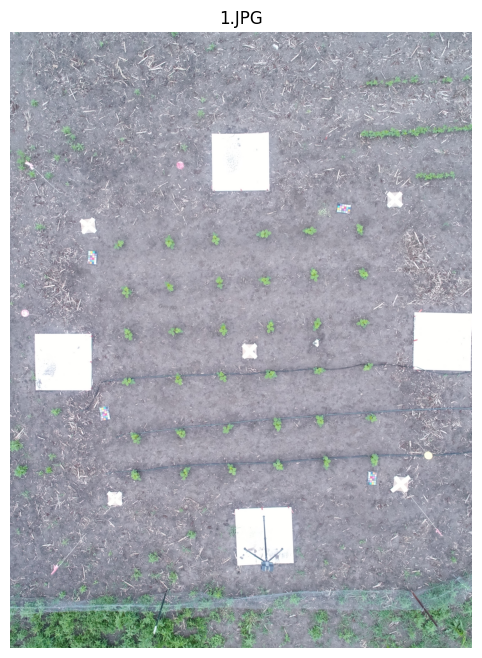

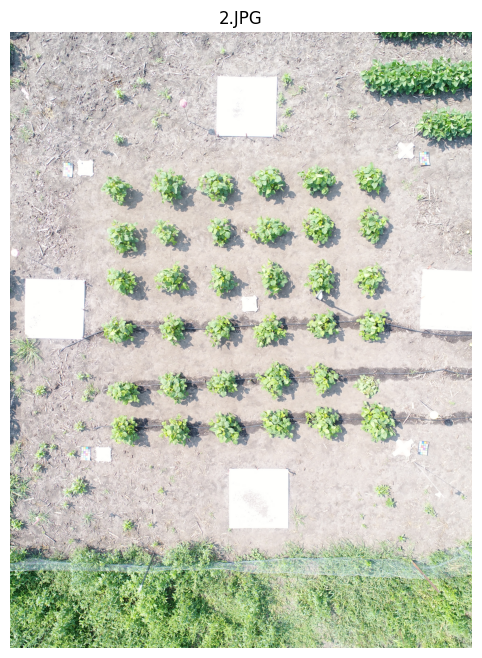

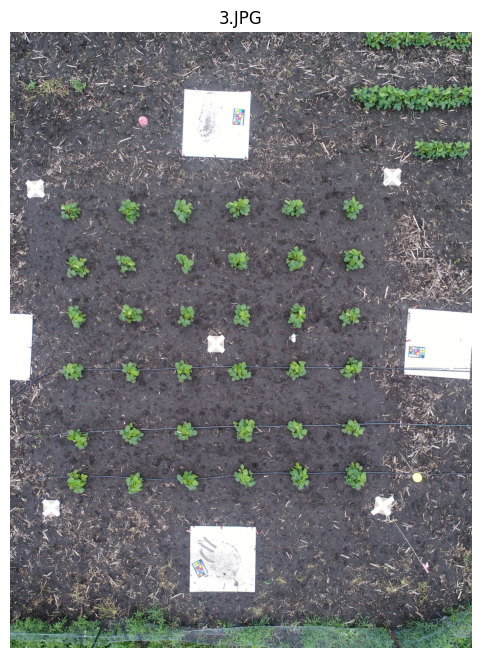

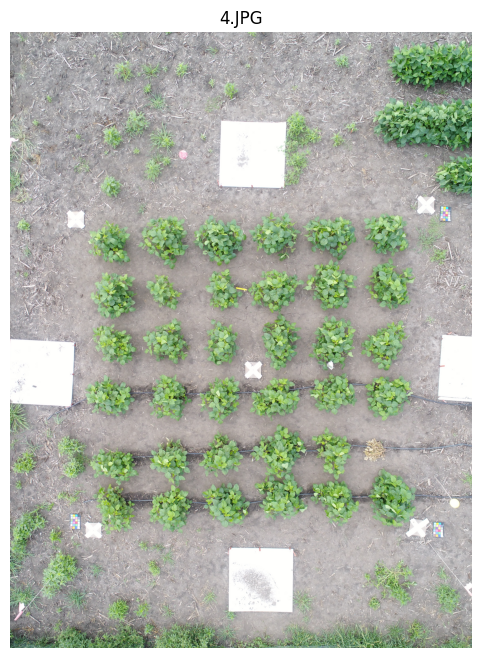

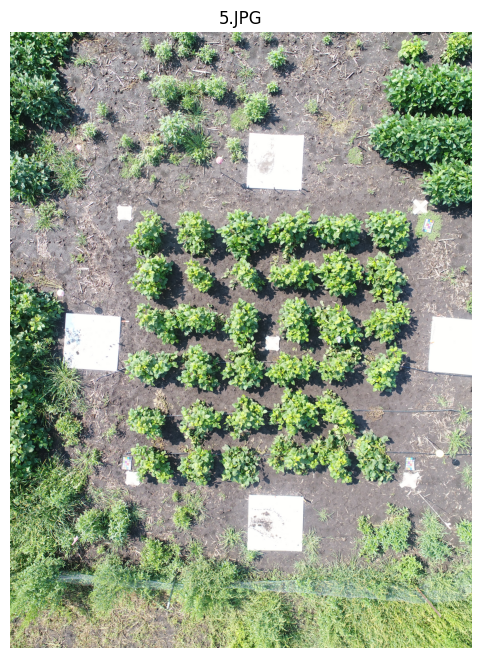

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files

uploaded = files.upload()

img_paths = sorted(list(uploaded.keys()))

print(f"Total images uploaded: {len(img_paths)}")

def read_image(path):
    img_bgr = cv2.imread(path)
    if img_bgr is None:
        print(f"Could not read {path}")
    return img_bgr

def show_image(img_bgr, title=""):
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(8,8))
    plt.imshow(img_rgb)
    plt.title(title)
    plt.axis("off")
    plt.show()

for path in img_paths:
    img = read_image(path)
    show_image(img, title=path)

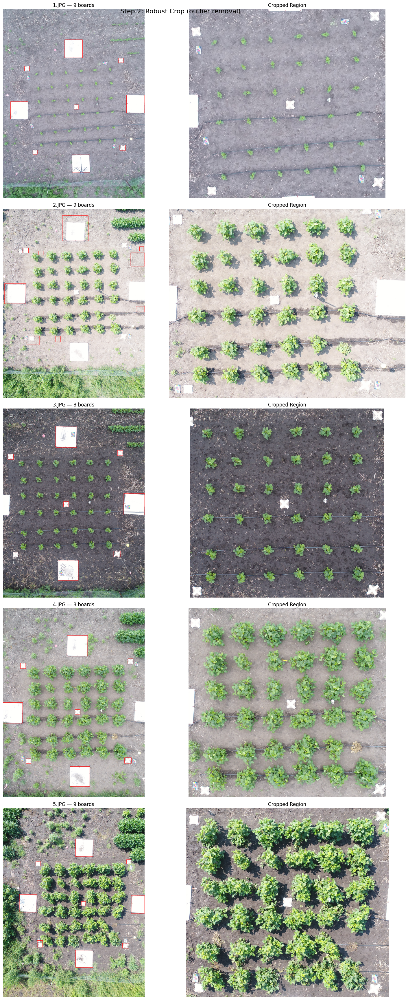

In [ ]:
def detect_white_boards(img_bgr, min_area=5000):
    gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)
    _, thresh = cv2.threshold(gray, 200, 255, cv2.THRESH_BINARY)

    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (15, 15))
    thresh = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)
    thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)

    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    boards = []
    for cnt in contours:
        area = cv2.contourArea(cnt)
        if area > min_area:
            x, y, w, h = cv2.boundingRect(cnt)
            aspect = max(w, h) / (min(w, h) + 1)
            if aspect < 1.5:
                cx, cy = x + w // 2, y + h // 2
                boards.append({'x': x, 'y': y, 'w': w, 'h': h,
                               'cx': cx, 'cy': cy, 'area': area})

    boards.sort(key=lambda b: b['area'], reverse=True)
    boards = boards[:9]
    return boards

def crop_field_region(img_bgr, boards):
    all_cx = sorted([b['cx'] for b in boards])
    all_cy = sorted([b['cy'] for b in boards])

    if len(all_cx) > 4:
        x_min = all_cx[1]
        x_max = all_cx[-2]
        y_min = all_cy[1]
        y_max = all_cy[-2]
    else:
        x_min = all_cx[0]
        x_max = all_cx[-1]
        y_min = all_cy[0]
        y_max = all_cy[-1]

    pad = 100
    h, w = img_bgr.shape[:2]
    x_min = max(0, x_min - pad)
    y_min = max(0, y_min - pad)
    x_max = min(w, x_max + pad)
    y_max = min(h, y_max + pad)

    cropped = img_bgr[y_min:y_max, x_min:x_max]
    return cropped, (x_min, y_min, x_max, y_max)

fig, axes = plt.subplots(5, 2, figsize=(16, 35))

cropped_images = {}

for i, path in enumerate(img_paths):
    img = read_image(path)
    boards = detect_white_boards(img)

    img_vis = img.copy()
    for b in boards:
        cv2.rectangle(img_vis, (b['x'], b['y']), (b['x']+b['w'], b['y']+b['h']), (0, 0, 255), 5)

    axes[i, 0].imshow(cv2.cvtColor(img_vis, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title(f"{path} — {len(boards)} boards")
    axes[i, 0].axis('off')

    if len(boards) >= 4:
        cropped, bbox = crop_field_region(img, boards)
        cropped_images[path] = cropped
        axes[i, 1].imshow(cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB))
        axes[i, 1].set_title(f"Cropped Region")
    else:
        axes[i, 1].set_title("Not enough boards!")
    axes[i, 1].axis('off')

plt.suptitle("Step 2: Robust Crop (outlier removal)", fontsize=16)
plt.tight_layout()
plt.show()

Processing 1.JPG...
  Found 36 subplots (after edge filter)
Processing 2.JPG...
  Found 36 subplots (after edge filter)
Processing 3.JPG...
  Found 36 subplots (after edge filter)
Processing 4.JPG...
  Found 35 subplots (after edge filter)
Processing 5.JPG...
  Found 35 subplots (after edge filter)


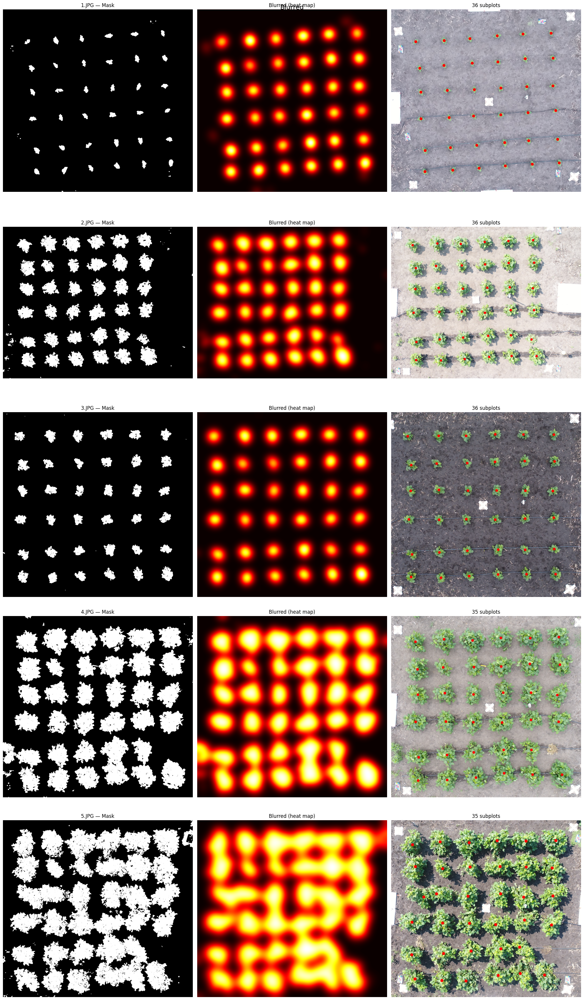

In [22]:
from scipy.ndimage import maximum_filter, minimum_filter, label, center_of_mass
from scipy.ndimage import gaussian_filter

def find_subplots_blur(img_bgr):
    mask = get_green_mask(img_bgr)

    mask_float = mask.astype(np.float64)
    blurred = gaussian_filter(mask_float, sigma=60)

    local_max = maximum_filter(blurred, size=150)
    detected_maxima = (blurred == local_max) & (blurred > blurred.max() * 0.25)

    labeled, num_features = label(detected_maxima)
    centroids = center_of_mass(detected_maxima, labeled, range(1, num_features + 1))

    h, w = img_bgr.shape[:2]
    margin = 100
    filtered = []
    for cy, cx in centroids:
        if margin < cx < w - margin and margin < cy < h - margin:
            filtered.append((cy, cx))

    print(f"  Found {len(filtered)} subplots (after edge filter)")
    return filtered, blurred, mask


fig, axes = plt.subplots(5, 3, figsize=(20, 35))

all_centroids_blur = {}

for i, path in enumerate(img_paths):
    print(f"Processing {path}...")
    cropped = cropped_images[path]
    centroids, blurred, mask = find_subplots_blur(cropped)
    all_centroids_blur[path] = centroids

    vis = cropped.copy()
    for cy, cx in centroids:
        cv2.circle(vis, (int(cx), int(cy)), 20, (0, 0, 255), -1)

    axes[i, 0].imshow(mask, cmap='gray')
    axes[i, 0].set_title(f"{path} — Mask")
    axes[i, 0].axis('off')

    axes[i, 1].imshow(blurred, cmap='hot')
    axes[i, 1].set_title("Blurred (heat map)")
    axes[i, 1].axis('off')

    axes[i, 2].imshow(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB))
    axes[i, 2].set_title(f"{len(centroids)} subplots")
    axes[i, 2].axis('off')

plt.suptitle("Blurred", fontsize=16)
plt.tight_layout()
plt.show()

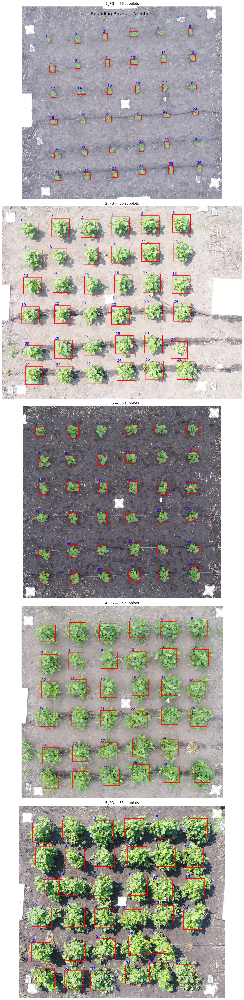

In [24]:
from scipy.spatial import cKDTree

def draw_bboxes(img_bgr, centroids):
    mask = get_green_mask(img_bgr)
    green_pixels = np.column_stack(np.where(mask > 0))

    centers_array = np.array(centroids)
    tree = cKDTree(centers_array)
    _, labels = tree.query(green_pixels)

    plots = []
    for i in range(len(centroids)):
        cluster = green_pixels[labels == i]
        if len(cluster) < 100:
            continue

        cy, cx = centroids[i]
        dist_y = np.abs(cluster[:, 0] - cy)
        dist_x = np.abs(cluster[:, 1] - cx)
        max_dist = 120
        valid = (dist_y < max_dist) & (dist_x < max_dist)
        cluster = cluster[valid]

        if len(cluster) < 50:
            continue

        y_min = cluster[:, 0].min()
        y_max = cluster[:, 0].max()
        x_min = cluster[:, 1].min()
        x_max = cluster[:, 1].max()
        plots.append({
            'x': int(x_min), 'y': int(y_min),
            'w': int(x_max - x_min), 'h': int(y_max - y_min),
            'cx': float(cx), 'cy': float(cy)
        })

    plots.sort(key=lambda p: p['cy'])
    n_per_row = 6
    sorted_plots = []
    for row in range(len(plots) // n_per_row + 1):
        start = row * n_per_row
        end = min(start + n_per_row, len(plots))
        row_plots = plots[start:end]
        row_plots.sort(key=lambda p: p['cx'])
        sorted_plots.extend(row_plots)

    vis = img_bgr.copy()
    for idx, p in enumerate(sorted_plots):
        cv2.rectangle(vis, (p['x'], p['y']),
                      (p['x']+p['w'], p['y']+p['h']), (0, 0, 255), 3)
        cv2.putText(vis, str(idx+1), (p['x'], p['y']-10),
                    cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255, 0, 0), 4)

    return vis, sorted_plots

fig, axes = plt.subplots(5, 1, figsize=(14, 50))

for i, path in enumerate(img_paths):
    cropped = cropped_images[path]
    centroids = all_centroids_blur[path]
    vis, plots = draw_bboxes(cropped, centroids)

    axes[i].imshow(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB))
    axes[i].set_title(f"{path} — {len(plots)} subplots")
    axes[i].axis('off')

plt.suptitle("Bounding Boxes + Numbers", fontsize=16)
plt.tight_layout()
plt.show()